#  Vector Basics
Date: 03.05.2024    
Lecturers: Harald Kristen & 
Matthias Wecht

## Course Outlook

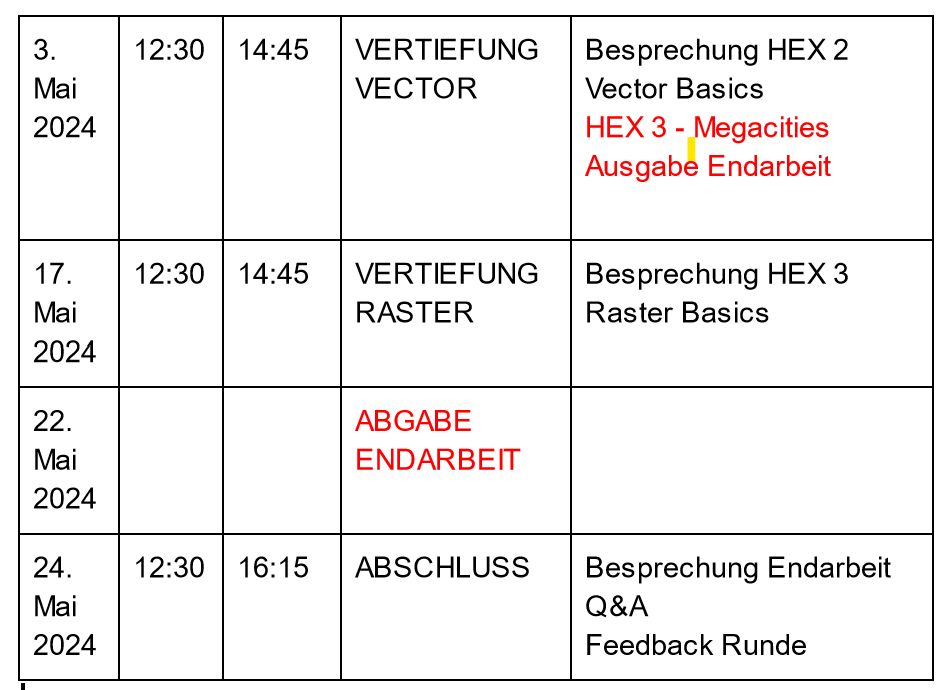

## Agenda
- **Review HEX 2** // 12:30 - 12:45
- Setup geopandas etc
- Read & write vector data
- Change CRS, calculate area & centroid
- Classify data
- Exercise I - Distance of two points // 13:15 - 13:40
- **BREAK 10 min** 13:40 - 13:50 
- Basic plotting
- Interactive plots
- Buffer points
- Clip polygons
- Spatial Joins
- **Reveal HEX 3 + Final Submission**  // 14:20 - 14:45




**This is a hands - on lesson!!** 

We will …   
… do more hands-on work with real vector data	   
… use a good portion of the skills from previous classes       
… learn to use new exciting python packages to handle vector data   

## Setup geopandas etc.

Use the **conda** package manger in a terminal to install geopandas and some additonal dependencies into your conda environment.
 If you want to learn more about geopandas, check its amazing [user guide](https://geopandas.org/en/stable/docs/user_guide.html) and the [examples](https://geopandas.org/en/stable/gallery/index.html).     

In [1]:
#conda install geopandas 
#conda install rtree pygeos #we need those two for spatial joins/select by location
#conda install folium matplotlib mapclassify

In [2]:
import geopandas as gpd
from pathlib import Path
import os

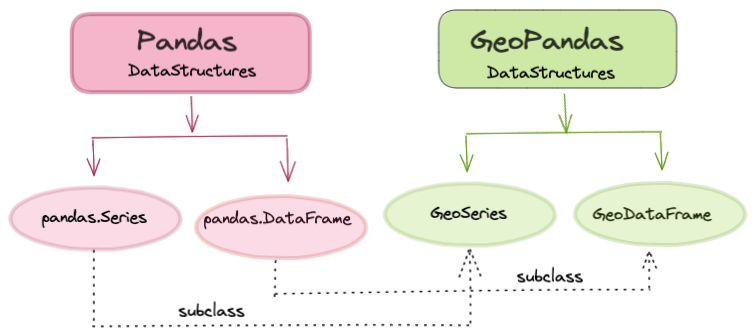

Source: https://towardsdatascience.com/interactive-geographical-maps-with-geopandas-4586a9d7cc10

## Read &  write vector data

Please downlod the ZIP file for this lesson. It contains four datasets. The first two are part of your geopandas installation. The second two are sourced from https://data.steiermark.at
- *naturalearth_cities*: global major cities 
- *naturalearth_lowres*: global borders of all countries 
- *bezirksgrenzen_stmk_4258*: the borders of the Styrian districs
- *orte_stmk_32633*: all towns in Styria

In [3]:
data_folder_pth = Path('EGM_2024_Vector_Basics_Data')

In [4]:
list(data_folder_pth.glob('*'))

[WindowsPath('EGM_2024_Vector_Basics_Data/bezirksgrenzen_stmk_4258.gpkg'),
 WindowsPath('EGM_2024_Vector_Basics_Data/cities.geojson'),
 WindowsPath('EGM_2024_Vector_Basics_Data/countries.gpkg'),
 WindowsPath('EGM_2024_Vector_Basics_Data/orte_stmk_32633.gpkg'),
 WindowsPath('EGM_2024_Vector_Basics_Data/bezirksgrenzen_stmk.shp'),
 WindowsPath('EGM_2024_Vector_Basics_Data/bezirksgrenzen_stmk.shx'),
 WindowsPath('EGM_2024_Vector_Basics_Data/bezirksgrenzen_stmk.dbf'),
 WindowsPath('EGM_2024_Vector_Basics_Data/bezirksgrenzen_stmk.cpg'),
 WindowsPath('EGM_2024_Vector_Basics_Data/bezirksgrenzen_stmk.prj'),
 WindowsPath('EGM_2024_Vector_Basics_Data/S2B_MSIL2A_20210614T100029_binary_mask.tif')]

In [5]:
Path.cwd()

WindowsPath('g:/.shortcut-targets-by-id/1kmw2ChlKBlX-qzJuPJP4TZSApH98rU3g/EGM_2024/20240503_Vector_Basics')

In [6]:
# Change the working directory to the folder where the data for this lesson is 
#This makes it easier to re-use the code afterwards. 
os.chdir(data_folder_pth)
Path.cwd()

WindowsPath('g:/.shortcut-targets-by-id/1kmw2ChlKBlX-qzJuPJP4TZSApH98rU3g/EGM_2024/20240503_Vector_Basics/EGM_2024_Vector_Basics_Data')

In [7]:
def check_files_in_cwd():
    # Check if the files are actually there
    file_list = list(Path.cwd().glob('*'))
    return file_list

check_files_in_cwd()

[WindowsPath('g:/.shortcut-targets-by-id/1kmw2ChlKBlX-qzJuPJP4TZSApH98rU3g/EGM_2024/20240503_Vector_Basics/EGM_2024_Vector_Basics_Data/bezirksgrenzen_stmk_4258.gpkg'),
 WindowsPath('g:/.shortcut-targets-by-id/1kmw2ChlKBlX-qzJuPJP4TZSApH98rU3g/EGM_2024/20240503_Vector_Basics/EGM_2024_Vector_Basics_Data/cities.geojson'),
 WindowsPath('g:/.shortcut-targets-by-id/1kmw2ChlKBlX-qzJuPJP4TZSApH98rU3g/EGM_2024/20240503_Vector_Basics/EGM_2024_Vector_Basics_Data/countries.gpkg'),
 WindowsPath('g:/.shortcut-targets-by-id/1kmw2ChlKBlX-qzJuPJP4TZSApH98rU3g/EGM_2024/20240503_Vector_Basics/EGM_2024_Vector_Basics_Data/orte_stmk_32633.gpkg'),
 WindowsPath('g:/.shortcut-targets-by-id/1kmw2ChlKBlX-qzJuPJP4TZSApH98rU3g/EGM_2024/20240503_Vector_Basics/EGM_2024_Vector_Basics_Data/bezirksgrenzen_stmk.shp'),
 WindowsPath('g:/.shortcut-targets-by-id/1kmw2ChlKBlX-qzJuPJP4TZSApH98rU3g/EGM_2024/20240503_Vector_Basics/EGM_2024_Vector_Basics_Data/bezirksgrenzen_stmk.shx'),
 WindowsPath('g:/.shortcut-targets-by-id/1k

In [8]:
cities = gpd.read_file('cities.geojson')
countries = gpd.read_file('countries.gpkg')
bezirksgrenzen_stmk = gpd.read_file('bezirksgrenzen_stmk_4258.gpkg')
orte_stmk = gpd.read_file('orte_stmk_32633.gpkg')

In [9]:
cities.head()

,name,worldcity,megacity,latitude,longitude,pop_max,pop_min,pop_other,geometry
0,Colonia del Sacramento,0.0,0,-34.479999,-57.840002,21714,21714,0,POINT (-57.84000 -34.48000)
1,Trinidad,0.0,0,-33.543999,-56.900997,21093,21093,0,POINT (-56.90100 -33.54400)
2,Fray Bentos,0.0,0,-33.138999,-58.303997,23279,23279,0,POINT (-58.30400 -33.13900)
3,Canelones,0.0,0,-34.538004,-56.284001,19698,19698,0,POINT (-56.28400 -34.53800)
4,Florida,0.0,0,-34.099002,-56.214998,32234,32234,0,POINT (-56.21500 -34.09900)


In [10]:
cities.head().geometry

0    POINT (-57.84000 -34.48000)
1    POINT (-56.90100 -33.54400)
2    POINT (-58.30400 -33.13900)
3    POINT (-56.28400 -34.53800)
4    POINT (-56.21500 -34.09900)
Name: geometry, dtype: geometry

In [12]:
cities.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 7343 entries, 0 to 7342
Data columns (total 9 columns):
 #   Column     Non-Null Count  Dtype   
---  ------     --------------  -----   
 0   name       7343 non-null   object  
 1   worldcity  7343 non-null   float64 
 2   megacity   7343 non-null   int64   
 3   latitude   7343 non-null   float64 
 4   longitude  7343 non-null   float64 
 5   pop_max    7343 non-null   int64   
 6   pop_min    7343 non-null   int64   
 7   pop_other  7343 non-null   int64   
 8   geometry   7343 non-null   geometry
dtypes: float64(3), geometry(1), int64(4), object(1)
memory usage: 516.4+ KB


In [13]:
orte_stmk.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1487 entries, 0 to 1486
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   ORTSNAME  1487 non-null   object  
 1   ORTSCODE  1487 non-null   int64   
 2   Art       1487 non-null   object  
 3   geometry  1487 non-null   geometry
dtypes: geometry(1), int64(1), object(2)
memory usage: 46.6+ KB


In [14]:
orte_stmk.head()

,ORTSNAME,ORTSCODE,Art,geometry
0,Mariazell,50,Hauptort einer Gemeinde,POINT (523861.584 5291090.602)
1,Halltal,50,Hauptort einer Gemeinde,POINT (528067.623 5289740.592)
2,Wildalpen,50,Hauptort einer Gemeinde,POINT (499014.887 5279006.164)
3,Oberort,60,Hauptort einer Katastralgemeinde,POINT (505901.973 5264383.206)
4,Pichl-Großdorf,50,Hauptort einer Gemeinde,POINT (505416.368 5261519.477)


In [15]:
bezirksgrenzen_stmk.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 13 entries, 0 to 12
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   BEZNR       13 non-null     object  
 1   BEZNR6      13 non-null     object  
 2   BEZNAM      13 non-null     object  
 3   KFZ         13 non-null     object  
 4   FLAECHE_HA  13 non-null     float64 
 5   geometry    13 non-null     geometry
dtypes: float64(1), geometry(1), object(4)
memory usage: 756.0+ bytes


In [17]:
bezirksgrenzen_stmk.head().geometry

0    POLYGON ((15.40183 47.13435, 15.40201 47.13433...
1    POLYGON ((15.31430 46.97278, 15.31481 46.97254...
2    POLYGON ((15.27834 47.34311, 15.27925 47.34285...
3    POLYGON ((15.59396 47.01890, 15.59419 47.01843...
4    POLYGON ((14.93562 47.61075, 14.93627 47.61030...
Name: geometry, dtype: geometry

In [18]:
countries.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 253 entries, 0 to 252
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   NAME        253 non-null    object  
 1   POP_EST     253 non-null    int64   
 2   POP_RANK    253 non-null    int64   
 3   GDP_MD_EST  253 non-null    float64 
 4   POP_YEAR    253 non-null    int64   
 5   LASTCENSUS  253 non-null    int64   
 6   GDP_YEAR    253 non-null    int64   
 7   ECONOMY     253 non-null    object  
 8   INCOME_GRP  253 non-null    object  
 9   CONTINENT   253 non-null    object  
 10  geometry    253 non-null    geometry
dtypes: float64(1), geometry(1), int64(5), object(4)
memory usage: 21.9+ KB


In [24]:
countries.head()

,NAME,POP_EST,POP_RANK,GDP_MD_EST,POP_YEAR,LASTCENSUS,GDP_YEAR,ECONOMY,INCOME_GRP,CONTINENT,geometry
0,Indonesia,260580739,17,3028000.0,2017,2010,2016,4. Emerging region: MIKT,4. Lower middle income,Asia,"MULTIPOLYGON (((117.70361 4.16341, 117.70361 4..."
1,Malaysia,31381992,15,863000.0,2017,2010,2016,6. Developing region,3. Upper middle income,Asia,"MULTIPOLYGON (((117.70361 4.16341, 117.69711 4..."
2,Chile,17789267,14,436100.0,2017,2002,2016,5. Emerging region: G20,3. Upper middle income,South America,"MULTIPOLYGON (((-69.51009 -17.50659, -69.50611..."
3,Bolivia,11138234,14,78350.0,2017,2001,2016,5. Emerging region: G20,4. Lower middle income,South America,"MULTIPOLYGON (((-69.51009 -17.50659, -69.51009..."
4,Peru,31036656,15,410400.0,2017,2007,2016,5. Emerging region: G20,3. Upper middle income,South America,"MULTIPOLYGON (((-69.51009 -17.50659, -69.63832..."


In [25]:
orte_stmk.crs

<Projected CRS: EPSG:32633>
Name: WGS 84 / UTM zone 33N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 12°E and 18°E, northern hemisphere between equator and 84°N, onshore and offshore. Austria. Bosnia and Herzegovina. Cameroon. Central African Republic. Chad. Congo. Croatia. Czechia. Democratic Republic of the Congo (Zaire). Gabon. Germany. Hungary. Italy. Libya. Malta. Niger. Nigeria. Norway. Poland. San Marino. Slovakia. Slovenia. Svalbard. Sweden. Vatican City State.
- bounds: (12.0, 0.0, 18.0, 84.0)
Coordinate Operation:
- name: UTM zone 33N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [27]:
# you can write a GDF to a shapefile
# https://geopandas.org/en/stable/docs/user_guide/io.html#writing-spatial-data
bezirksgrenzen_stmk.to_file('bezirksgrenzen_stmk_TEST.shp')

In [28]:
check_files_in_cwd()

[WindowsPath('g:/.shortcut-targets-by-id/1kmw2ChlKBlX-qzJuPJP4TZSApH98rU3g/EGM_2024/20240503_Vector_Basics/EGM_2024_Vector_Basics_Data/bezirksgrenzen_stmk_4258.gpkg'),
 WindowsPath('g:/.shortcut-targets-by-id/1kmw2ChlKBlX-qzJuPJP4TZSApH98rU3g/EGM_2024/20240503_Vector_Basics/EGM_2024_Vector_Basics_Data/cities.geojson'),
 WindowsPath('g:/.shortcut-targets-by-id/1kmw2ChlKBlX-qzJuPJP4TZSApH98rU3g/EGM_2024/20240503_Vector_Basics/EGM_2024_Vector_Basics_Data/countries.gpkg'),
 WindowsPath('g:/.shortcut-targets-by-id/1kmw2ChlKBlX-qzJuPJP4TZSApH98rU3g/EGM_2024/20240503_Vector_Basics/EGM_2024_Vector_Basics_Data/orte_stmk_32633.gpkg'),
 WindowsPath('g:/.shortcut-targets-by-id/1kmw2ChlKBlX-qzJuPJP4TZSApH98rU3g/EGM_2024/20240503_Vector_Basics/EGM_2024_Vector_Basics_Data/bezirksgrenzen_stmk.shp'),
 WindowsPath('g:/.shortcut-targets-by-id/1kmw2ChlKBlX-qzJuPJP4TZSApH98rU3g/EGM_2024/20240503_Vector_Basics/EGM_2024_Vector_Basics_Data/bezirksgrenzen_stmk.shx'),
 WindowsPath('g:/.shortcut-targets-by-id/1k

## CRS, area, centroid

Now we know a bit about the datasets we'll use. But to combine them, they all should be in the same coordinate reference system (CRS). Let's check the CRS of the data sets and try to **re-project** them. Then we can:
- calculate the area for each poylgon in m²
- centroid of each polygon
  

For further reference see [GPD Intro documenation ](https://geopandas.org/en/v0.10.2/getting_started/introduction.html )as a reference.

In [29]:
data_lst = [cities, countries, bezirksgrenzen_stmk, orte_stmk]
for dataset in data_lst:
  print(dataset.crs)

EPSG:4326
EPSG:4326
EPSG:4258
EPSG:32633


In [35]:
bezirksgrenzen_stmk.crs

<Geographic 2D CRS: EPSG:4258>
Name: ETRS89
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: Europe - onshore and offshore: Albania; Andorra; Austria; Belgium; Bosnia and Herzegovina; Bulgaria; Croatia; Cyprus; Czechia; Denmark; Estonia; Faroe Islands; Finland; France; Germany; Gibraltar; Greece; Hungary; Ireland; Italy; Kosovo; Latvia; Liechtenstein; Lithuania; Luxembourg; Malta; Moldova; Monaco; Montenegro; Netherlands; North Macedonia; Norway including Svalbard and Jan Mayen; Poland; Portugal; Romania; San Marino; Serbia; Slovakia; Slovenia; Spain; Sweden; Switzerland; United Kingdom (UK) including Channel Islands and Isle of Man; Vatican City State.
- bounds: (-16.1, 32.88, 40.18, 84.73)
Datum: European Terrestrial Reference System 1989 ensemble
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
orte_stmk.crs

In [30]:
orte_stmk.crs == bezirksgrenzen_stmk.crs

False

In [34]:
bezirksgrenzen_stmk.to_crs?

Signature: bezirksgrenzen_stmk.to_crs(crs=None, epsg=None, inplace=False)
Docstring:
Transform geometries to a new coordinate reference system.

Transform all geometries in an active geometry column to a different coordinate
reference system.  The ``crs`` attribute on the current GeoSeries must
be set.  Either ``crs`` or ``epsg`` may be specified for output.

This method will transform all points in all objects. It has no notion
of projecting entire geometries.  All segments joining points are
assumed to be lines in the current projection, not geodesics. Objects
crossing the dateline (or other projection boundary) will have
undesirable behavior.

Parameters
----------
crs : pyproj.CRS, optional if `epsg` is specified
    The value can be anything accepted by
    :meth:`pyproj.CRS.from_user_input() <pyproj.crs.CRS.from_user_input>`,
    such as an authority string (eg "EPSG:4326") or a WKT string.
epsg : int, optional if `crs` is specified
    EPSG code specifying output projection.
inp

In [36]:
bezirksgrenzen_stmk_32633 = bezirksgrenzen_stmk.to_crs(epsg = 32633)

In [37]:
bezirksgrenzen_stmk_32633.head().geometry

0    POLYGON ((530472.715 5220172.211, 530486.701 5...
1    POLYGON ((523906.655 5202187.426, 523945.493 5...
2    POLYGON ((521025.146 5243331.328, 521093.711 5...
3    POLYGON ((545140.290 5207435.585, 545158.356 5...
4    POLYGON ((495161.187 5273040.387, 495210.487 5...
Name: geometry, dtype: geometry

In [38]:
bezirksgrenzen_stmk.head().geometry

0    POLYGON ((15.40183 47.13435, 15.40201 47.13433...
1    POLYGON ((15.31430 46.97278, 15.31481 46.97254...
2    POLYGON ((15.27834 47.34311, 15.27925 47.34285...
3    POLYGON ((15.59396 47.01890, 15.59419 47.01843...
4    POLYGON ((14.93562 47.61075, 14.93627 47.61030...
Name: geometry, dtype: geometry

In [50]:
bezirksgrenzen_stmk_32633.crs

<Projected CRS: EPSG:32633>
Name: WGS 84 / UTM zone 33N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 12°E and 18°E, northern hemisphere between equator and 84°N, onshore and offshore. Austria. Bosnia and Herzegovina. Cameroon. Central African Republic. Chad. Congo. Croatia. Czechia. Democratic Republic of the Congo (Zaire). Gabon. Germany. Hungary. Italy. Libya. Malta. Niger. Nigeria. Norway. Poland. San Marino. Slovakia. Slovenia. Svalbard. Sweden. Vatican City State.
- bounds: (12.0, 0.0, 18.0, 84.0)
Coordinate Operation:
- name: UTM zone 33N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [42]:
bezirksgrenzen_stmk_32633.area

0     1.274650e+08
1     8.637971e+08
2     1.086096e+09
3     7.510647e+08
4     1.051941e+09
5     3.316900e+09
6     1.383956e+09
7     6.790815e+08
8     1.097769e+09
9     1.675508e+09
10    2.154605e+09
11    1.227542e+09
12    9.850665e+08
dtype: float64

In [48]:
# save area of all districts to a new column -> this will be in meter, same as the crs
bezirksgrenzen_stmk_32633['area'] = bezirksgrenzen_stmk_32633.area
bezirksgrenzen_stmk_32633['centroid'] = bezirksgrenzen_stmk_32633.centroid

In [47]:
bezirksgrenzen_stmk_32633.head()

,BEZNR,BEZNR6,BEZNAM,KFZ,FLAECHE_HA,geometry,area,centroid
0,01,601,Graz Stadt,G,12746.0,"POLYGON ((530472.715 5220172.211, 530486.701 5...",1,POINT (533354.271 5213605.156)
1,03,603,Deutschlandsberg,DL,86379.0,"POLYGON ((523906.655 5202187.426, 523945.493 5...",1,POINT (515129.871 5183779.181)
2,06,606,Graz Umgebung,GU,108609.0,"POLYGON ((521025.146 5243331.328, 521093.711 5...",1,POINT (529148.862 5219323.839)
3,10,610,Leibnitz,LB,75106.0,"POLYGON ((545140.290 5207435.585, 545158.356 5...",1,POINT (540285.285 5180987.475)
4,11,611,Leoben,LE,105194.0,"POLYGON ((495161.187 5273040.387, 495210.487 5...",1,POINT (493534.100 5252120.009)


## Classify  data

In [51]:
cities.head()

,name,worldcity,megacity,latitude,longitude,pop_max,pop_min,pop_other,geometry
0,Colonia del Sacramento,0.0,0,-34.479999,-57.840002,21714,21714,0,POINT (-57.84000 -34.48000)
1,Trinidad,0.0,0,-33.543999,-56.900997,21093,21093,0,POINT (-56.90100 -33.54400)
2,Fray Bentos,0.0,0,-33.138999,-58.303997,23279,23279,0,POINT (-58.30400 -33.13900)
3,Canelones,0.0,0,-34.538004,-56.284001,19698,19698,0,POINT (-56.28400 -34.53800)
4,Florida,0.0,0,-34.099002,-56.214998,32234,32234,0,POINT (-56.21500 -34.09900)


In [54]:
cities.describe()

,worldcity,megacity,latitude,longitude,pop_max,pop_min,pop_other
count,7343.000000,7343.000000,7343.000000,7343.000000,7.343000e+03,7.343000e+03,7.343000e+03
mean,0.009533,0.080349,20.496166,10.987582,3.218734e+05,2.078131e+05,4.137240e+05
std,0.097177,0.271851,29.263073,79.435193,1.066623e+06,6.414873e+05,1.258383e+06
min,0.000000,0.000000,-89.982894,-179.589979,-9.900000e+01,-9.900000e+01,0.000000e+00
25%,0.000000,0.000000,-0.674573,-64.781974,1.947850e+04,1.337000e+04,0.000000e+00
50%,0.000000,0.000000,26.640298,18.699985,6.945100e+04,5.003200e+04,3.981700e+04
75%,0.000000,0.000000,43.532008,73.292415,2.297540e+05,1.634720e+05,2.230085e+05
max,1.000000,1.000000,82.483323,179.383304,3.567600e+07,1.460851e+07,2.145995e+07


In [56]:
cities.loc[cities.worldcity == 1]

,name,worldcity,megacity,latitude,longitude,pop_max,pop_min,pop_other,geometry
880,Vatican City,1.0,0,41.900012,12.447808,832,832,562430,POINT (12.45339 41.90328)
7168,Boston,1.0,1,42.329960,-71.070014,4467000,589141,2238083,POINT (-71.07196 42.33191)
7176,Budapest,1.0,1,47.500006,19.083321,1679000,1679000,1718895,POINT (19.08137 47.50195)
7178,Barcelona,1.0,1,41.383300,2.183370,4920000,1581595,105111,POINT (2.18142 41.38525)
7179,Bucharest,1.0,1,44.433372,26.099947,1942000,1742194,1636574,POINT (26.09800 44.43532)
...,...,...,...,...,...,...,...,...,...
7338,Rio de Janeiro,1.0,1,-22.925023,-43.225021,11748000,2010175,1821489,POINT (-43.22697 -22.92308)
7339,São Paulo,1.0,1,-23.558680,-46.625020,18845000,10021295,11522944,POINT (-46.62697 -23.55673)
7340,Sydney,1.0,1,-33.920011,151.185180,4630000,3641422,2669348,POINT (151.18323 -33.91807)
7341,Singapore,1.0,1,1.293033,103.855821,5183700,3289529,3314179,POINT (103.85387 1.29498)


In [55]:
cities[cities.worldcity == 1]

,name,worldcity,megacity,latitude,longitude,pop_max,pop_min,pop_other,geometry
880,Vatican City,1.0,0,41.900012,12.447808,832,832,562430,POINT (12.45339 41.90328)
7168,Boston,1.0,1,42.329960,-71.070014,4467000,589141,2238083,POINT (-71.07196 42.33191)
7176,Budapest,1.0,1,47.500006,19.083321,1679000,1679000,1718895,POINT (19.08137 47.50195)
7178,Barcelona,1.0,1,41.383300,2.183370,4920000,1581595,105111,POINT (2.18142 41.38525)
7179,Bucharest,1.0,1,44.433372,26.099947,1942000,1742194,1636574,POINT (26.09800 44.43532)
...,...,...,...,...,...,...,...,...,...
7338,Rio de Janeiro,1.0,1,-22.925023,-43.225021,11748000,2010175,1821489,POINT (-43.22697 -22.92308)
7339,São Paulo,1.0,1,-23.558680,-46.625020,18845000,10021295,11522944,POINT (-46.62697 -23.55673)
7340,Sydney,1.0,1,-33.920011,151.185180,4630000,3641422,2669348,POINT (151.18323 -33.91807)
7341,Singapore,1.0,1,1.293033,103.855821,5183700,3289529,3314179,POINT (103.85387 1.29498)


In [57]:
huge_worldcities = cities[(cities.worldcity == 1) & (cities.pop_max >15000000 )]
huge_worldcities

,name,worldcity,megacity,latitude,longitude,pop_max,pop_min,pop_other,geometry
7318,New York,1.0,1,40.749979,-73.980017,19040000,8008278,9292603,POINT (-73.98196 40.75192)
7324,Mexico City,1.0,1,19.442442,-99.130988,19028000,10811002,10018444,POINT (-99.13293 19.44439)
7333,Tokyo,1.0,1,35.685017,139.751407,35676000,8336599,12945252,POINT (139.74946 35.68696)
7334,Mumbai,1.0,1,19.016990,72.856989,18978000,12691836,12426085,POINT (72.85504 19.01894)
7339,São Paulo,1.0,1,-23.558680,-46.625020,18845000,10021295,11522944,POINT (-46.62697 -23.55673)


## Exercise I - Distance of two points

- Calculate the centroid distance between the district in styria with largest and the smallest area.

**Hint**   
You can either use a Geopandas inbuilt function **gdf.distance()** for this. Or calculate the [euclidian distance](https://en.wikipedia.org/wiki/Euclidean_distance) for 2-dimensions, [with the numpy package](https://itsmycode.com/calculate-euclidean-distance-in-python/). 

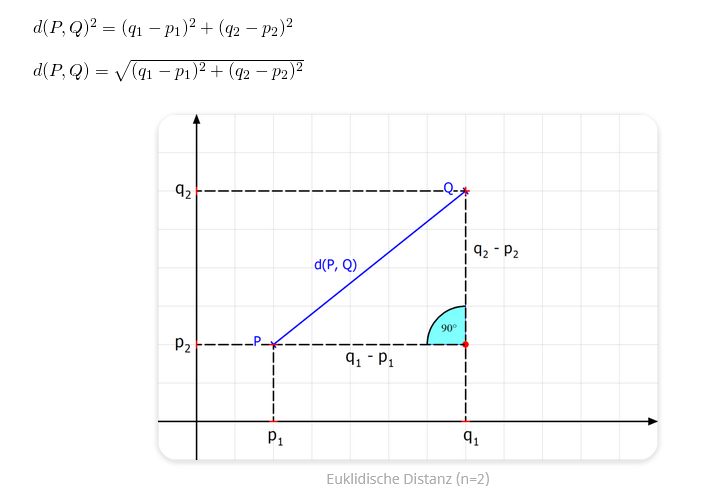


## Basic plotting

<Axes: >

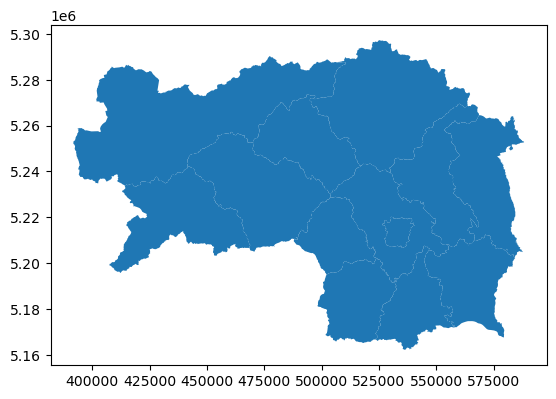

In [59]:
bezirksgrenzen_stmk_32633.plot()

<Axes: >

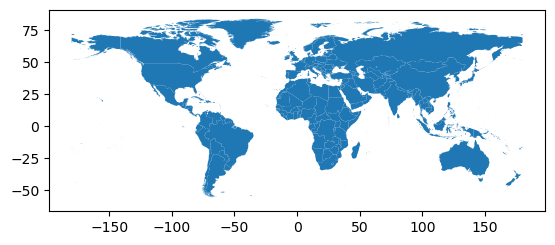

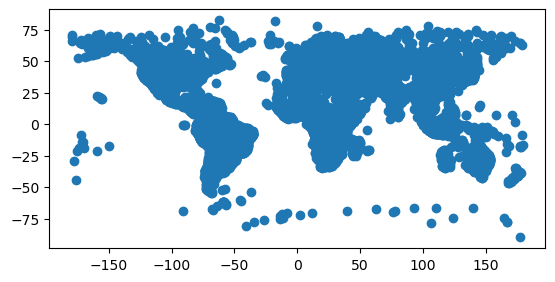

In [60]:
countries.plot()
cities.plot()

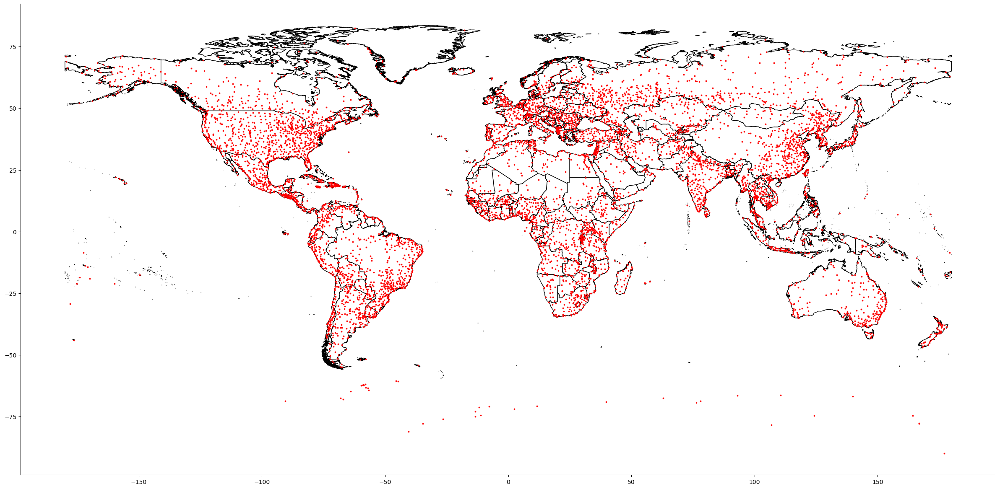

In [63]:
base = countries.plot(color='white', edgecolor='black', figsize=(30,30))
cities.plot(ax=base, marker='o', color='red', markersize=3);

## Interactive plots
We are using [gdfexplore()](https://geopandas.org/en/stable/docs/reference/api/geopandas.GeoDataFrame.explore.html) for quick and easy interactive plots: 
Plotting not producing great cartography, but good overview   

- Basic functionality
https://geopandas.org/en/stable/gallery/plotting_with_folium.html
- Advanced plots https://towardsdatascience.com/interactive-geographical-maps-with-geopandas-4586a9d7cc10

In [64]:
import folium
import mapclassify

In [65]:
countries.explore()

In [66]:
# save the above map as HTML page, you can e.g. embed in your own web page
countries.explore().save('countries_plot.html')

In [67]:
countries.head()

,NAME,POP_EST,POP_RANK,GDP_MD_EST,POP_YEAR,LASTCENSUS,GDP_YEAR,ECONOMY,INCOME_GRP,CONTINENT,geometry
0,Indonesia,260580739,17,3028000.0,2017,2010,2016,4. Emerging region: MIKT,4. Lower middle income,Asia,"MULTIPOLYGON (((117.70361 4.16341, 117.70361 4..."
1,Malaysia,31381992,15,863000.0,2017,2010,2016,6. Developing region,3. Upper middle income,Asia,"MULTIPOLYGON (((117.70361 4.16341, 117.69711 4..."
2,Chile,17789267,14,436100.0,2017,2002,2016,5. Emerging region: G20,3. Upper middle income,South America,"MULTIPOLYGON (((-69.51009 -17.50659, -69.50611..."
3,Bolivia,11138234,14,78350.0,2017,2001,2016,5. Emerging region: G20,4. Lower middle income,South America,"MULTIPOLYGON (((-69.51009 -17.50659, -69.51009..."
4,Peru,31036656,15,410400.0,2017,2007,2016,5. Emerging region: G20,3. Upper middle income,South America,"MULTIPOLYGON (((-69.51009 -17.50659, -69.63832..."


In [68]:
# do more fancy plots with gdf.explore()
europe_countries = countries[countries.CONTINENT == 'Europe']
europe_countries.explore(column = 'POP_EST', cmap='Set3', tiles =  "CartoDB positron")

## Buffer Points

In [69]:
orte_stmk.crs

<Projected CRS: EPSG:32633>
Name: WGS 84 / UTM zone 33N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 12°E and 18°E, northern hemisphere between equator and 84°N, onshore and offshore. Austria. Bosnia and Herzegovina. Cameroon. Central African Republic. Chad. Congo. Croatia. Czechia. Democratic Republic of the Congo (Zaire). Gabon. Germany. Hungary. Italy. Libya. Malta. Niger. Nigeria. Norway. Poland. San Marino. Slovakia. Slovenia. Svalbard. Sweden. Vatican City State.
- bounds: (12.0, 0.0, 18.0, 84.0)
Coordinate Operation:
- name: UTM zone 33N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [71]:
orte_stmk.buffer(1000).explore()

In [72]:
orte_stmk.head()

,ORTSNAME,ORTSCODE,Art,geometry
0,Mariazell,50,Hauptort einer Gemeinde,POINT (523861.584 5291090.602)
1,Halltal,50,Hauptort einer Gemeinde,POINT (528067.623 5289740.592)
2,Wildalpen,50,Hauptort einer Gemeinde,POINT (499014.887 5279006.164)
3,Oberort,60,Hauptort einer Katastralgemeinde,POINT (505901.973 5264383.206)
4,Pichl-Großdorf,50,Hauptort einer Gemeinde,POINT (505416.368 5261519.477)


In [73]:
orte_stmk.buffer(1000).head()

0    POLYGON ((524861.584 5291090.602, 524856.769 5...
1    POLYGON ((529067.623 5289740.592, 529062.808 5...
2    POLYGON ((500014.887 5279006.164, 500010.072 5...
3    POLYGON ((506901.973 5264383.206, 506897.157 5...
4    POLYGON ((506416.368 5261519.477, 506411.553 5...
dtype: geometry

## Clip polygons

https://geopandas.org/en/stable/gallery/plot_clip.html

In [74]:
from shapely.geometry import Polygon
# Create a custom polygon with shapely

polygon = Polygon([(0, 0), (0, 90), (180, 90), (180, 0), (0, 0)])
poly_gdf = gpd.GeoDataFrame([1], geometry=[polygon], crs=countries.crs)

In [75]:
countries_clipped = countries.clip(poly_gdf)

<Axes: >

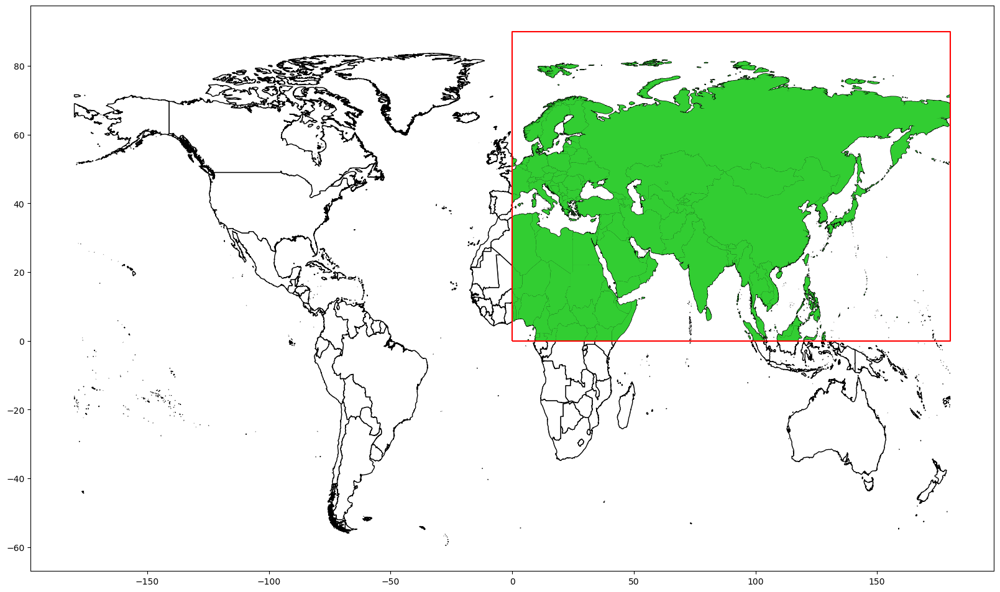

In [76]:
base_clip = countries.plot(color='white', edgecolor='black', figsize=(20,20))
countries_clipped.plot(ax=base_clip, color='limegreen')
poly_gdf.boundary.plot(ax=base_clip, color = 'red')

## Spatial joins

Find out in which countries the biggest worldcities are situated

In [77]:
countries.head()

,NAME,POP_EST,POP_RANK,GDP_MD_EST,POP_YEAR,LASTCENSUS,GDP_YEAR,ECONOMY,INCOME_GRP,CONTINENT,geometry
0,Indonesia,260580739,17,3028000.0,2017,2010,2016,4. Emerging region: MIKT,4. Lower middle income,Asia,"MULTIPOLYGON (((117.70361 4.16341, 117.70361 4..."
1,Malaysia,31381992,15,863000.0,2017,2010,2016,6. Developing region,3. Upper middle income,Asia,"MULTIPOLYGON (((117.70361 4.16341, 117.69711 4..."
2,Chile,17789267,14,436100.0,2017,2002,2016,5. Emerging region: G20,3. Upper middle income,South America,"MULTIPOLYGON (((-69.51009 -17.50659, -69.50611..."
3,Bolivia,11138234,14,78350.0,2017,2001,2016,5. Emerging region: G20,4. Lower middle income,South America,"MULTIPOLYGON (((-69.51009 -17.50659, -69.51009..."
4,Peru,31036656,15,410400.0,2017,2007,2016,5. Emerging region: G20,3. Upper middle income,South America,"MULTIPOLYGON (((-69.51009 -17.50659, -69.63832..."


In [79]:
huge_worldcities

,name,worldcity,megacity,latitude,longitude,pop_max,pop_min,pop_other,geometry
7318,New York,1.0,1,40.749979,-73.980017,19040000,8008278,9292603,POINT (-73.98196 40.75192)
7324,Mexico City,1.0,1,19.442442,-99.130988,19028000,10811002,10018444,POINT (-99.13293 19.44439)
7333,Tokyo,1.0,1,35.685017,139.751407,35676000,8336599,12945252,POINT (139.74946 35.68696)
7334,Mumbai,1.0,1,19.016990,72.856989,18978000,12691836,12426085,POINT (72.85504 19.01894)
7339,São Paulo,1.0,1,-23.558680,-46.625020,18845000,10021295,11522944,POINT (-46.62697 -23.55673)


In [81]:
countries.head()

,NAME,POP_EST,POP_RANK,GDP_MD_EST,POP_YEAR,LASTCENSUS,GDP_YEAR,ECONOMY,INCOME_GRP,CONTINENT,geometry
0,Indonesia,260580739,17,3028000.0,2017,2010,2016,4. Emerging region: MIKT,4. Lower middle income,Asia,"MULTIPOLYGON (((117.70361 4.16341, 117.70361 4..."
1,Malaysia,31381992,15,863000.0,2017,2010,2016,6. Developing region,3. Upper middle income,Asia,"MULTIPOLYGON (((117.70361 4.16341, 117.69711 4..."
2,Chile,17789267,14,436100.0,2017,2002,2016,5. Emerging region: G20,3. Upper middle income,South America,"MULTIPOLYGON (((-69.51009 -17.50659, -69.50611..."
3,Bolivia,11138234,14,78350.0,2017,2001,2016,5. Emerging region: G20,4. Lower middle income,South America,"MULTIPOLYGON (((-69.51009 -17.50659, -69.51009..."
4,Peru,31036656,15,410400.0,2017,2007,2016,5. Emerging region: G20,3. Upper middle income,South America,"MULTIPOLYGON (((-69.51009 -17.50659, -69.63832..."


In [78]:
#make sure that rtree 6 pygeos are installed before using *sjoin* !!
huge_worldcities_countries = huge_worldcities.sjoin(countries, how="inner", predicate='within')
huge_worldcities_countries

,name,worldcity,megacity,latitude,longitude,pop_max,pop_min,pop_other,geometry,index_right,NAME,POP_EST,POP_RANK,GDP_MD_EST,POP_YEAR,LASTCENSUS,GDP_YEAR,ECONOMY,INCOME_GRP,CONTINENT
7318,New York,1.0,1,40.749979,-73.980017,19040000,8008278,9292603,POINT (-73.98196 40.75192),153,United States of America,326625791,17,18560000.0,2017,2010,2016,1. Developed region: G7,1. High income: OECD,North America
7324,Mexico City,1.0,1,19.442442,-99.130988,19028000,10811002,10018444,POINT (-99.13293 19.44439),155,Mexico,124574795,17,2307000.0,2017,2010,2016,4. Emerging region: MIKT,3. Upper middle income,North America
7333,Tokyo,1.0,1,35.685017,139.751407,35676000,8336599,12945252,POINT (139.74946 35.68696),185,Japan,126451398,17,4932000.0,2017,2010,2016,1. Developed region: G7,1. High income: OECD,Asia
7334,Mumbai,1.0,1,19.016990,72.856989,18978000,12691836,12426085,POINT (72.85504 19.01894),8,India,1281935911,18,8721000.0,2017,2011,2016,3. Emerging region: BRIC,4. Lower middle income,Asia
7339,São Paulo,1.0,1,-23.558680,-46.625020,18845000,10021295,11522944,POINT (-46.62697 -23.55673),45,Brazil,207353391,17,3081000.0,2017,2010,2016,3. Emerging region: BRIC,3. Upper middle income,South America


In [84]:
countries.sjoin(huge_worldcities, how="inner", predicate='contains')

,NAME,POP_EST,POP_RANK,GDP_MD_EST,POP_YEAR,LASTCENSUS,GDP_YEAR,ECONOMY,INCOME_GRP,CONTINENT,geometry,index_right,name,worldcity,megacity,latitude,longitude,pop_max,pop_min,pop_other
8,India,1281935911,18,8721000.0,2017,2011,2016,3. Emerging region: BRIC,4. Lower middle income,Asia,"MULTIPOLYGON (((77.80035 35.49541, 77.81533 35...",7334,Mumbai,1.0,1,19.016990,72.856989,18978000,12691836,12426085
45,Brazil,207353391,17,3081000.0,2017,2010,2016,3. Emerging region: BRIC,3. Upper middle income,South America,"MULTIPOLYGON (((-57.61170 -30.18296, -57.56865...",7339,São Paulo,1.0,1,-23.558680,-46.625020,18845000,10021295,11522944
153,United States of America,326625791,17,18560000.0,2017,2010,2016,1. Developed region: G7,1. High income: OECD,North America,"MULTIPOLYGON (((-95.16057 49.36949, -95.10282 ...",7318,New York,1.0,1,40.749979,-73.980017,19040000,8008278,9292603
155,Mexico,124574795,17,2307000.0,2017,2010,2016,4. Emerging region: MIKT,3. Upper middle income,North America,"MULTIPOLYGON (((-97.13927 25.96581, -97.16747 ...",7324,Mexico City,1.0,1,19.442442,-99.130988,19028000,10811002,10018444
185,Japan,126451398,17,4932000.0,2017,2010,2016,1. Developed region: G7,1. High income: OECD,Asia,"MULTIPOLYGON (((129.78321 31.79963, 129.79086 ...",7333,Tokyo,1.0,1,35.685017,139.751407,35676000,8336599,12945252
